In [1]:
#df.grade.value_counts()

In [76]:
#Setting up environment with initial libraries needed for importing, cleaning, and initial visualization
import numpy as np
import pandas as pd
from pandas_profiling import ProfileReport
from scipy import stats
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
import cufflinks as cf
from datetime import datetime
import sweetviz as sv

import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 25)
pd.set_option('display.float_format', '{:,}'.format)

sns.set_style('darkgrid')

%matplotlib inline

#read King County Housing csv data into new dataframe with Pandas and assign it to the variable kchouse_df
df = pd.read_csv('kc_house_data.csv')

In [20]:
#create Pandas Profiling report using dataframe
kchouse_profile = ProfileReport(df, title="King Pandas Profiling Report")

#call Pandas Profile Report
kchouse_profile

In [93]:
#convert date col object strings to datetime objects and call first 5 rows
df['date'] = pd.to_datetime(df.date, format='%m/%d/%Y')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,2014-10-13,"221,900.0",3,1.0,1180,5650,1.0,nan,0.0,3,7,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,2014-12-09,"538,000.0",3,2.25,2570,7242,2.0,0.0,0.0,3,7,2170,400.0,1951,"1,991.0",98125,47.721000000000004,-122.319,1690,7639
2,5631500400,2015-02-25,"180,000.0",2,1.0,770,10000,1.0,0.0,0.0,3,6,770,0.0,1933,nan,98028,47.7379,-122.23299999999999,2720,8062
3,2487200875,2014-12-09,"604,000.0",4,3.0,1960,5000,1.0,0.0,0.0,5,7,1050,910.0,1965,0.0,98136,47.5208,-122.39299999999999,1360,5000
4,1954400510,2015-02-18,"510,000.0",3,2.0,1680,8080,1.0,0.0,0.0,3,8,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


In [23]:
# print('first sale', df.date.min())
# print('last sale', df.date.max())

first sale 2014-05-02 00:00:00
last sale 2015-05-27 00:00:00


In [94]:
#create new dataframe using groupby for date col by calendar quarter
kchouse_quarter = df.groupby(pd.Grouper(key='date', freq='Q'))

In [95]:
#call descriptive statistics for dataframe
kchouse_quarter.describe()

id                                                          \
             count                  mean                   std         min   
date                                                                         
2014-06-30 3,946.0  4,597,881,879.807653  2,885,400,763.234328 1,200,019.0   
2014-09-30 5,921.0  4,556,726,001.457524  2,864,857,340.594546 1,000,102.0   
2014-12-31 4,755.0 4,535,025,393.4576235 2,874,366,373.5429277 6,200,017.0   
2015-03-31 4,100.0  4,593,814,704.382195 2,894,508,436.7276297 3,600,057.0   
2015-06-30 2,875.0  4,661,634,993.662956   2,867,661,991.27217 1,000,102.0   

                                                                             \
                       25%             50%              75%             max   
date                                                                          
2014-06-30 2,111,010,145.0 3,905,045,230.0 7,346,950,410.25 9,842,300,540.0   
2014-09-30 2,125,049,131.0 3,892,500,070.0  7,237,450,080.0 9,895,000,040.0   
2014-12-31 2,113,700,505.0 3,882,300,100.0  7,283,900,281.5 9,900,000,190.0   
2015-03-31 2,025,700,877.5 3,905,085,875.0  7,375,150,092.5 9,842,300,485.0   
2015-06-30 2,254,300,716.0 3,959,400,335.0  7,449,500,370.0 9,839,301,060.0   

             price                                                  ...  \
             count               mean                 std      min  ...   
date                                                                ...   
2014-06-30 3,946.0 553,337.1246832235 374,403.44686948427 78,000.0  ...   
2014-09-30 5,921.0  537,657.722513089  362,730.8649094727 85,000.0  ...   
2014-12-31 4,755.0 529,852.6525762356 373,151.58202265936 82,000.0  ...   
2015-03-31 4,100.0 528,932.8585365854  349,703.7802656323 81,000.0  ...   
2015-06-30 2,875.0 561,311.7725217391  380,637.4008967785 84,000.0  ...   

           sqft_living15                         sqft_lot15  \
                     25%     50%     75%     max      count   
date                                                          
2014-06-30       1,490.0 1,870.0 2,420.0 5,790.0    3,946.0   
2014-09-30       1,500.0 1,860.0 2,390.0 5,790.0    5,921.0   
2014-12-31       1,470.0 1,830.0 2,330.0 6,110.0    4,755.0   
2015-03-31       1,470.0 1,810.0 2,330.0 6,210.0    4,100.0   
2015-06-30       1,500.0 1,830.0 2,328.0 5,500.0    2,875.0   

                                                                          \
                          mean                 std   min     25%     50%   
date                                                                       
2014-06-30 12,880.385200202736 24,512.599681684078 750.0 5,084.5 7,684.0   
2014-09-30 12,500.994595507516 24,731.749242096834 659.0 5,098.0 7,650.0   
2014-12-31 12,967.925341745531 28,770.628068342307 651.0 5,100.0 7,538.0   
2015-03-31  12,351.05268292683  28,285.00509902243 748.0 5,200.0 7,671.5   
2015-06-30 13,354.594434782608  31,528.35626157986 750.0 5,024.0 7,538.0   

                                
                 75%       max  
date                            
2014-06-30 10,439.25 392,040.0  
2014-09-30  10,160.0 434,728.0  
2014-12-31   9,904.0 560,617.0  
2015-03-31  10,000.0 871,200.0  
2015-06-30   9,964.0 858,132.0  

[5 rows x 152 columns]

In [96]:
#call size of dataframe
kchouse_quarter.size()

date
2014-06-30    3946
2014-09-30    5921
2014-12-31    4755
2015-03-31    4100
2015-06-30    2875
Freq: Q-DEC, dtype: int64

In [27]:
#call descriptive stats for price col for each calendar quarter in groupby dataframe
for qrtr in kchouse_quarter.groups:
    print(f'Quarter for End Date {qrtr}')
    print('median           ', kchouse_quarter.price.get_group(qrtr).median())
    print(kchouse_quarter.price.get_group(qrtr).describe())
    print('=========================================')


Quarter for End Date 2014-06-30 00:00:00
median            465000.0
count               3,946.0
mean     553,337.1246832235
std     374,403.44686948427
min                78,000.0
25%               329,936.5
50%               465,000.0
75%               660,000.0
max             7,060,000.0
Name: price, dtype: float64
Quarter for End Date 2014-09-30 00:00:00
median            450000.0
count              5,921.0
mean     537,657.722513089
std     362,730.8649094727
min               85,000.0
25%              325,000.0
50%              450,000.0
75%              640,000.0
max            6,890,000.0
Name: price, dtype: float64
Quarter for End Date 2014-12-31 00:00:00
median            439000.0
count               4,755.0
mean     529,852.6525762356
std     373,151.58202265936
min                82,000.0
25%               312,500.0
50%               439,000.0
75%               630,000.0
max             7,700,000.0
Name: price, dtype: float64
Quarter for End Date 2015-03-31 00:00:00
median 

In [28]:
#call descriptive stats for price col for each calendar quarter in groupby dataframe
for qrtr in kchouse_quarter.groups:
    print(f'Quarter for End Date {qrtr}')
    print('median           ', kchouse_quarter.sqft_living15.get_group(qrtr).median())
    print(kchouse_quarter.sqft_living15.get_group(qrtr).describe())
    print('=========================================')

Quarter for End Date 2014-06-30 00:00:00
median            1870.0
count               3,946.0
mean    2,020.0408008109478
std        704.615337793435
min                   460.0
25%                 1,490.0
50%                 1,870.0
75%                 2,420.0
max                 5,790.0
Name: sqft_living15, dtype: float64
Quarter for End Date 2014-09-30 00:00:00
median            1860.0
count               5,921.0
mean    2,004.4933288295897
std       688.6927623720635
min                   700.0
25%                 1,500.0
50%                 1,860.0
75%                 2,390.0
max                 5,790.0
Name: sqft_living15, dtype: float64
Quarter for End Date 2014-12-31 00:00:00
median            1830.0
count               4,755.0
mean    1,967.9896950578338
std       681.9373066622206
min                   620.0
25%                 1,470.0
50%                 1,830.0
75%                 2,330.0
max                 6,110.0
Name: sqft_living15, dtype: float64
Quarter for End Date 2

In [29]:
#create list of heatmap lat and long coordinates from dataframe using list comprehension and .iterrows() function
kchouse_heatdata = [[row['lat'], row['long']] for index, row in df.iterrows()]

In [30]:
#create list of map marker coordinates and price using list comprehension and iterrows() function
kchouse_markers = [[row['lat'], row['long'], row['price']] for index, row in df.iterrows()]

In [31]:
#call new list
kchouse_markers

[[47.5112, -122.257, 221900.0],
 [47.721000000000004, -122.319, 538000.0],
 [47.7379, -122.23299999999999, 180000.0],
 [47.5208, -122.39299999999999, 604000.0],
 [47.6168, -122.045, 510000.0],
 [47.6561, -122.005, 1230000.0],
 [47.3097, -122.32700000000001, 257500.0],
 [47.4095, -122.315, 291850.0],
 [47.5123, -122.337, 229500.0],
 [47.3684, -122.031, 323000.0],
 [47.6007, -122.145, 662500.0],
 [47.69, -122.292, 468000.0],
 [47.7558, -122.229, 310000.0],
 [47.6127, -122.045, 400000.0],
 [47.67, -122.39399999999999, 530000.0],
 [47.5714, -122.375, 650000.0],
 [47.7277, -121.962, 395000.0],
 [47.6648, -122.34299999999999, 485000.0],
 [47.3089, -122.21, 189000.0],
 [47.3343, -122.306, 230000.0],
 [47.7025, -122.34100000000001, 385000.0],
 [47.5316, -122.23299999999999, 2000000.0],
 [47.3266, -122.169, 285000.0],
 [47.3533, -122.166, 252700.0],
 [47.3739, -122.17200000000001, 329000.0],
 [47.3048, -122.21799999999999, 233000.0],
 [47.6386, -122.36, 937000.0],
 [47.6221, -122.314, 667000.0]

In [44]:
#create folium map with King County central coordinates and call map
kingcountycoords = (47.4700, -121.8400)
kchouse_heatmap = folium.Map(location=kingcountycoords, zoom_start = 9)
kchouse_heatmap

In [45]:
#add heatmap markers from list to fresh heatmap
HeatMap(kchouse_heatdata).add_to(kchouse_heatmap)

In [46]:
kchouse_heatmap

In [47]:
#create folium map with King County central coordinates and call map
kingcountycoords = (47.4700, -121.8400)
kchouse_markersmap = folium.Map(location=kingcountycoords, zoom_start = 9)
kchouse_markersmap

In [51]:
#add markers for lat and long coordinates with price popups to kchousemap2 using a lambda and .add_to functions
df.apply(lambda row:folium.CircleMarker(location=[row["lat"], row["long"]], 
                                              radius=1, popup=row['price'], clustered_marker=True)
                                             .add_to(kchouse_markersmap), axis=1)

0        <folium.vector_layers.CircleMarker object at 0...
1        <folium.vector_layers.CircleMarker object at 0...
2        <folium.vector_layers.CircleMarker object at 0...
3        <folium.vector_layers.CircleMarker object at 0...
4        <folium.vector_layers.CircleMarker object at 0...
                               ...                        
21592    <folium.vector_layers.CircleMarker object at 0...
21593    <folium.vector_layers.CircleMarker object at 0...
21594    <folium.vector_layers.CircleMarker object at 0...
21595    <folium.vector_layers.CircleMarker object at 0...
21596    <folium.vector_layers.CircleMarker object at 0...
Length: 21597, dtype: object

In [52]:
#call folium map
kchouse_markersmap

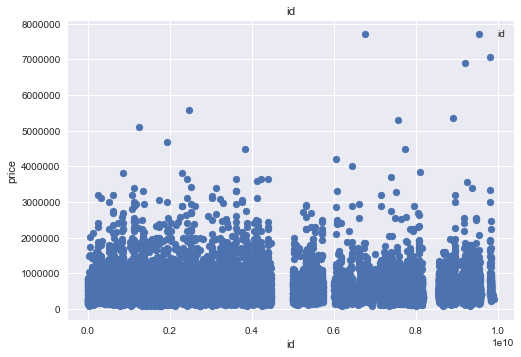

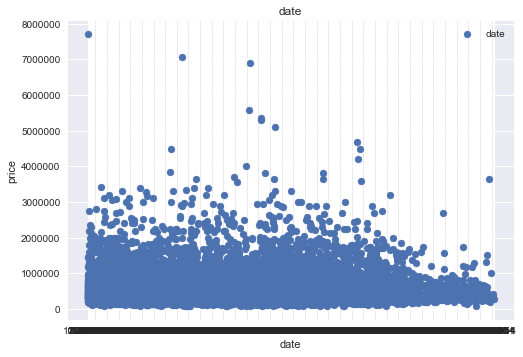

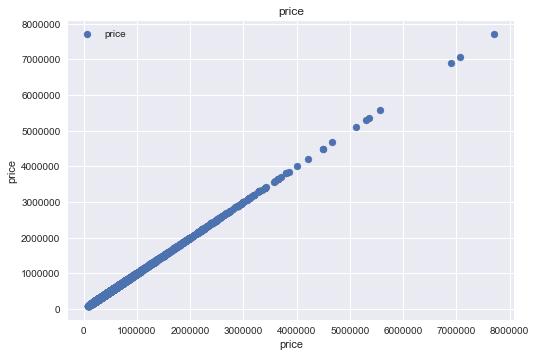

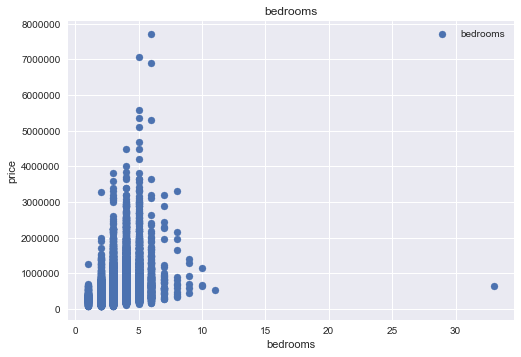

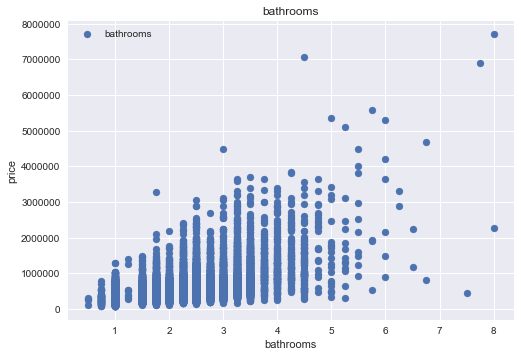

...

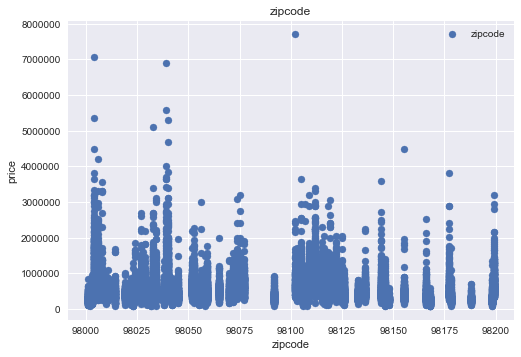

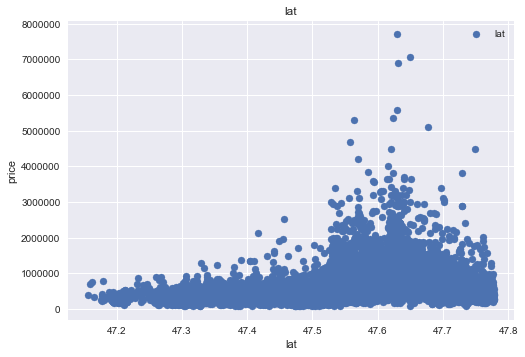

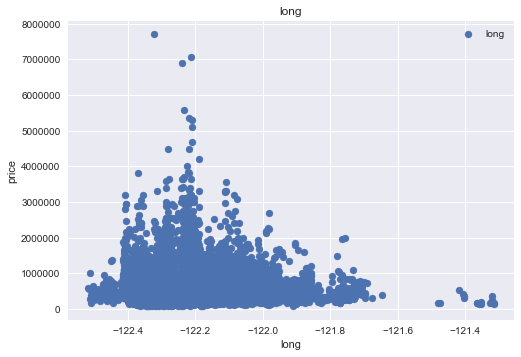

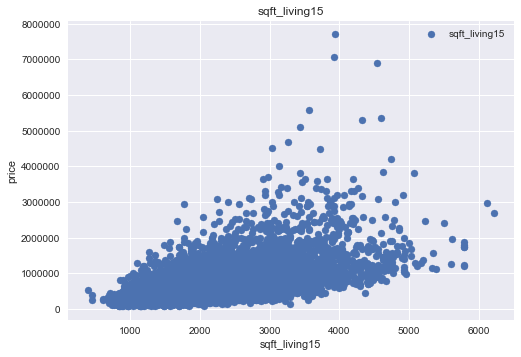

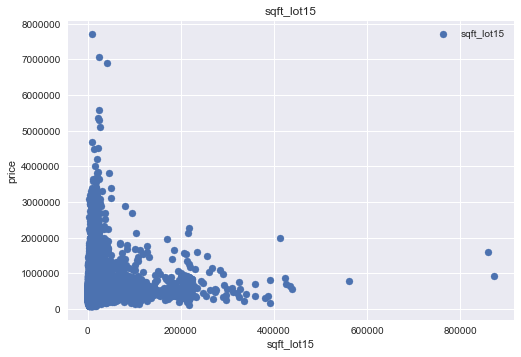

In [90]:
for col in df.columns: 
    plt.scatter(df[col], df.price, label=col)
    plt.legend()
    plt.xlabel(col)
    plt.ylabel('price')
    plt.title(col)
    plt.show()

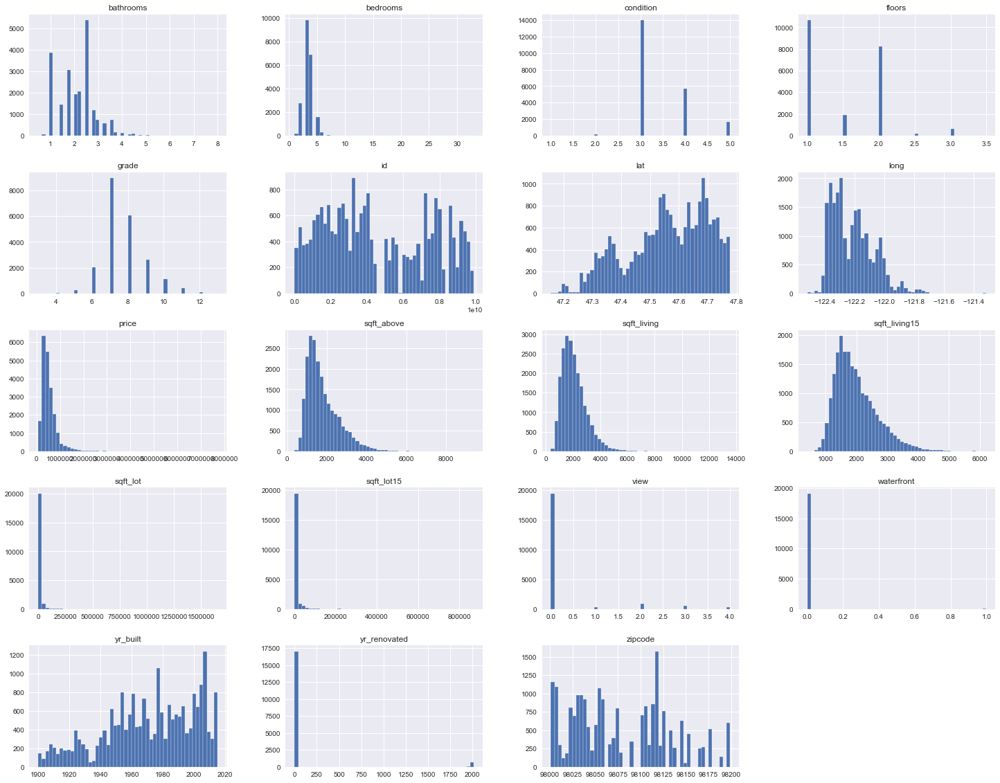

In [89]:
df.hist(bins=50, figsize=(25,20))
plt.show()

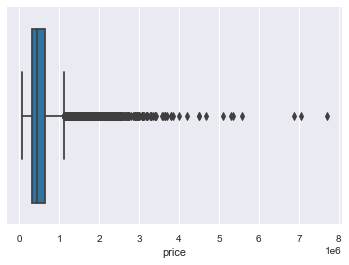

In [57]:
plt.figure()
ax = sns.boxplot(df.price)
plt.show()

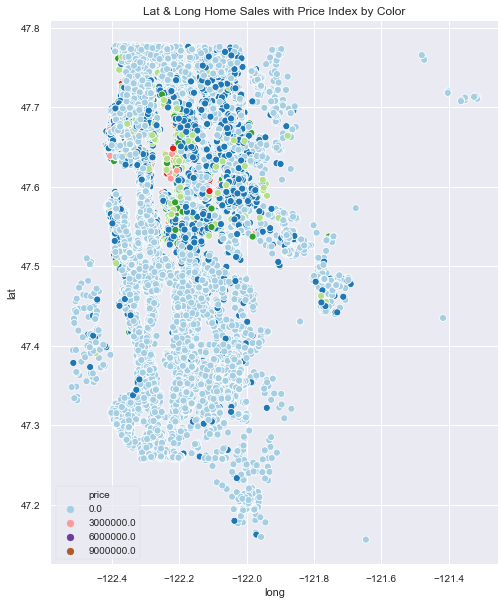

In [58]:
plt.figure(figsize=(8,10))
sns.scatterplot(x='long', y='lat', hue='price', data=df, palette='Paired')
plt.title('Lat & Long Home Sales with Price Index by Color')
plt.legend(fancybox=True);

array([[<AxesSubplot:title={'center':'bathrooms'}>,
        <AxesSubplot:title={'center':'bedrooms'}>,
        <AxesSubplot:title={'center':'condition'}>,
        <AxesSubplot:title={'center':'floors'}>],
       [<AxesSubplot:title={'center':'grade'}>,
        <AxesSubplot:title={'center':'id'}>,
        <AxesSubplot:title={'center':'lat'}>,
        <AxesSubplot:title={'center':'long'}>],
       [<AxesSubplot:title={'center':'price'}>,
        <AxesSubplot:title={'center':'sqft_above'}>,
        <AxesSubplot:title={'center':'sqft_living'}>,
        <AxesSubplot:title={'center':'sqft_living15'}>],
       [<AxesSubplot:title={'center':'sqft_lot'}>,
        <AxesSubplot:title={'center':'sqft_lot15'}>,
        <AxesSubplot:title={'center':'view'}>,
        <AxesSubplot:title={'center':'waterfront'}>],
       [<AxesSubplot:title={'center':'yr_built'}>,
        <AxesSubplot:title={'center':'yr_renovated'}>,
        <AxesSubplot:title={'center':'zipcode'}>, <AxesSubplot:>]],
      dtype=objec

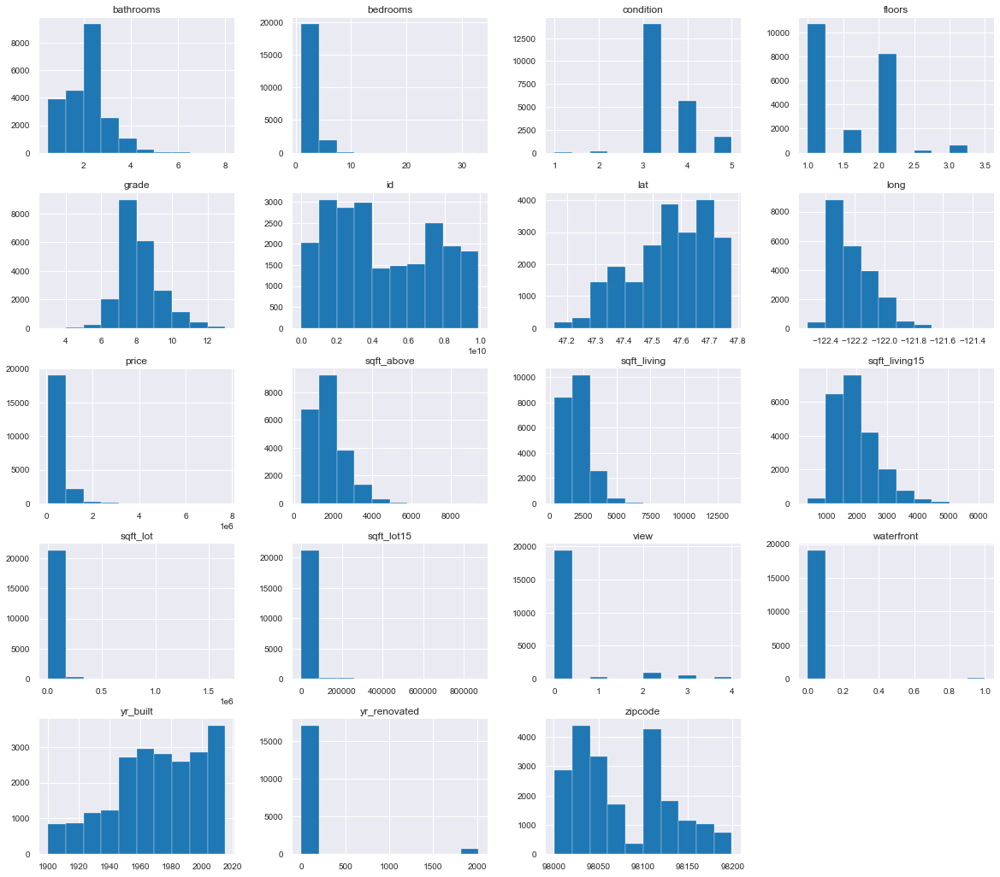

In [59]:
df.hist(figsize=(20,18))

In [60]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import scipy.stats as stats
import statsmodels.stats.api as sms
from statsmodels.formula.api import ols

outcome = 'price'

x_cols = df.drop(['price', 'date','sqft_basement', 'id'], axis=1).columns
predictors = '+'.join(x_cols)

f = outcome + '~' + predictors

model = smf.ols(formula=f, data=df).fit()
model.summary2()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                          Results: Ordinary least squares
===================================================================================
Model:                   OLS                   Adj. R-squared:          0.701      
Dependent Variable:      price                 AIC:                     430090.8562
Date:                    2020-08-02 03:56      BIC:                     430228.8327
No. Observations:        15762                 Log-Likelihood:          -2.1503e+05
Df Model:                17                    F-statistic:             2174.      
Df Residuals:            15744                 Prob (F-statistic):      0.00       
R-squared:               0.701                 Scale:                   4.1441e+10 
-----------------------------------------------------------------------------------
                 Coef.       Std.Err.      t     P>|t|      [0.025        0.975]   
-----------------------------------------------------------------------------------
Intercept     5302250.8039 3478624.8563   1.5242 0.1275 -1516252.8213 12120754.4290
bedrooms       -37498.7849    2219.5646 -16.8947 0.0000   -41849.3860   -33148.1838
bathrooms       44686.0252    3864.2123  11.5641 0.0000    37111.7259    52260.3245
sqft_living       154.5053       5.1688  29.8917 0.0000      144.3738      164.6369
sqft_lot            0.0939       0.0562   1.6698 0.0950       -0.0163        0.2040
floors           4029.0029    4268.3982   0.9439 0.3452    -4337.5471    12395.5529
waterfront     609833.7233   20547.6719  29.6790 0.0000   569557.9301   650109.5165
view            52830.6894    2552.7403  20.6957 0.0000    47827.0257    57834.3532
condition       26532.2196    2785.4886   9.5252 0.0000    21072.3426    31992.0966
grade           93751.2669    2570.6596  36.4697 0.0000    88712.4792    98790.0546
sqft_above         38.2463       5.1380   7.4439 0.0000       28.1753       48.3173
yr_built        -2674.2510      85.9581 -31.1111 0.0000    -2842.7386    -2505.7633
yr_renovated       19.8281       4.3677   4.5397 0.0000       11.2668       28.3894
zipcode          -571.0855      39.0778 -14.6141 0.0000     -647.6824     -494.4886
lat            604021.2106   12695.4957  47.5776 0.0000   579136.5833   628905.8380
long          -217438.3999   15570.8080 -13.9645 0.0000  -247958.9691  -186917.8307
sqft_living15      15.6360       4.1095   3.8049 0.0001        7.5810       23.6911
sqft_lot15         -0.3382       0.0846  -3.9975 0.0001       -0.5041       -0.1724
-----------------------------------------------------------------------------------
Omnibus:                  13694.698          Durbin-Watson:             1.980      
Prob(Omnibus):            0.000              Jarque-Bera (JB):          1491014.115
Skew:                     3.668              Prob(JB):                  0.000      
Kurtosis:                 50.080             Condition No.:             216078398  
===================================================================================
* The condition number is large (2e+08). This might indicate             strong
multicollinearity or other numerical problems.
"""

In [64]:
# ax = sns.distplot(df.groupby('price').mean(),kde=False)
# vals = ax.get_xticks()
# ax.set_xticklabels(['{:,.0f}%'.format(x*100) for x in vals])
# ax.set_title('Price')
# sns.despine()

In [66]:
import plotly.offline
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [73]:
# iplot_df = df.drop(['id'], axis=1)

In [75]:
# iplot_df.iplot()

In [79]:
sweetviz_report = sv.analyze(df, target_feat = 'price')
sweetviz_report.show_html('viz.html')

:FEATURES DONE:                    |█████████████████████| [100%]   00:14  -> (00:00 left)
:PAIRWISE DONE:                    |█████████████████████| [100%]   00:00  -> (00:00 left)


Creating Associations graph... DONE!
Report viz.html was generated! NOTEBOOK/COLAB USERS: no browser will pop up, the report is saved in your notebook/colab files.


In [80]:
sweetviz_report = sv.analyze(df)
sweetviz_report.show_html('viz1.html')

:FEATURES DONE:                    |█████████████████████| [100%]   00:11  -> (00:00 left)
:PAIRWISE DONE:                    |█████████████████████| [100%]   00:00  -> (00:00 left)


Creating Associations graph... DONE!
Report viz1.html was generated! NOTEBOOK/COLAB USERS: no browser will pop up, the report is saved in your notebook/colab files.


Shape of your Data Set: (21597, 21)
Classifying variables in data set...
    21 Predictors classified...
        This does not include the Target column(s)
    2 variables removed since they were ID or low-information variables
    List of variables removed: ['date', 'sqft_basement']
Since Number of Rows in data 21597 exceeds maximum, randomly sampling 2500 rows for EDA...
Number of All Scatter Plots = 10
Could not draw Distribution Plot
Could not draw Date Vars
Number of Categorical and Continuous Vars exceeds limit, hence no Bar Plots
Time to run AutoViz (in seconds) = 2.394


,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
156,6388930390,"650,000.0",5,3.5,3960,25245,2.0,0.0,0.0,3,9,2500,0.0,98056,47.525,-122.17200000000001,2640,13675
15572,2128000050,"625,000.0",4,2.25,2070,7200,1.0,0.0,0.0,5,8,1390,0.0,98033,47.696999999999996,-122.169,2110,8400
2080,4401200350,"822,500.0",3,2.5,3090,7708,2.0,0.0,0.0,3,10,3090,0.0,98052,47.6868,-122.10799999999999,3140,8592
17522,3356402232,"179,900.0",3,1.75,1230,12000,1.0,nan,0.0,3,6,1230,0.0,98001,47.2878,-122.251,1550,12000
8360,2212600100,"370,000.0",4,2.75,3150,67518,1.0,nan,0.0,4,9,2250,0.0,98092,47.3382,-122.196,2210,32391
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1143,5112800421,"225,500.0",4,2.0,1440,7950,1.0,0.0,0.0,5,6,1440,nan,98058,47.4517,-122.08200000000001,1530,20037
16697,1818800289,"795,000.0",3,2.75,1820,7517,1.0,0.0,0.0,3,9,1820,0.0,98116,47.5705,-122.406,2540,8035
18970,7977200945,"425,000.0",3,1.0,1000,5100,1.0,0.0,0.0,3,7,860,0.0,98115,47.6857,-122.29299999999999,1000,5100
20412,8149600065,"844,000.0",4,3.5,3350,6350,2.0,0.0,2.0,3,8,2610,0.0,98116,47.5602,-122.39,1820,6350


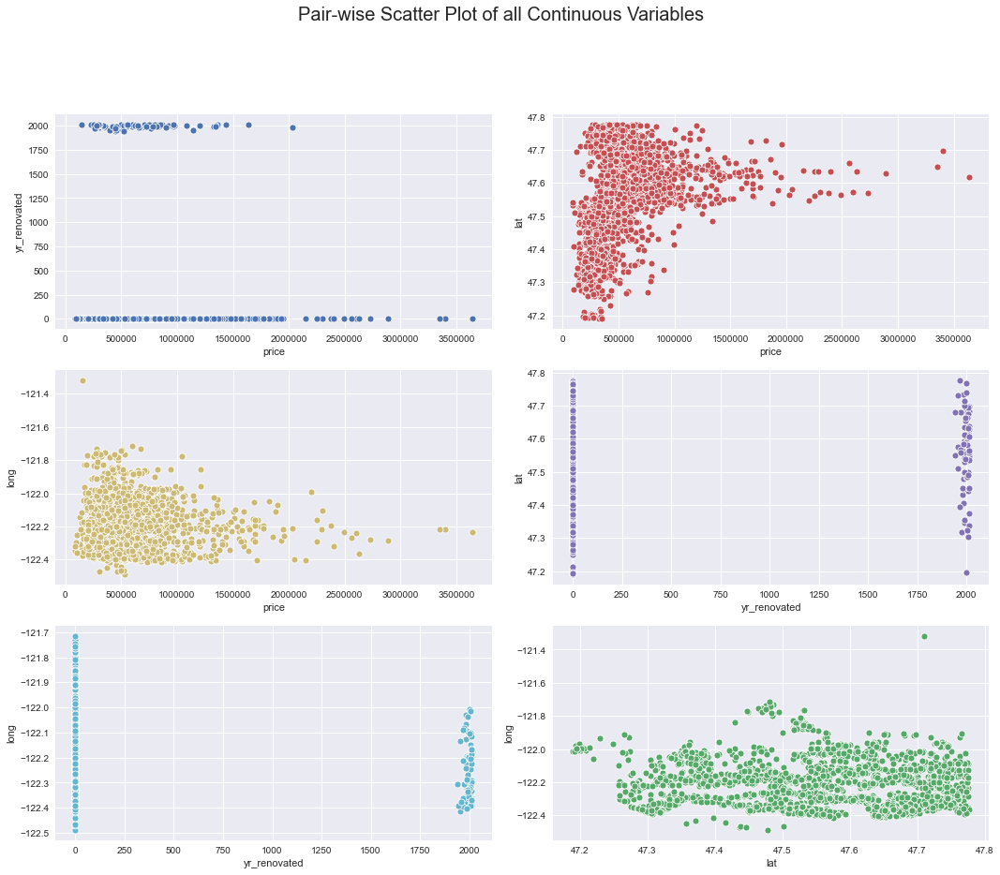

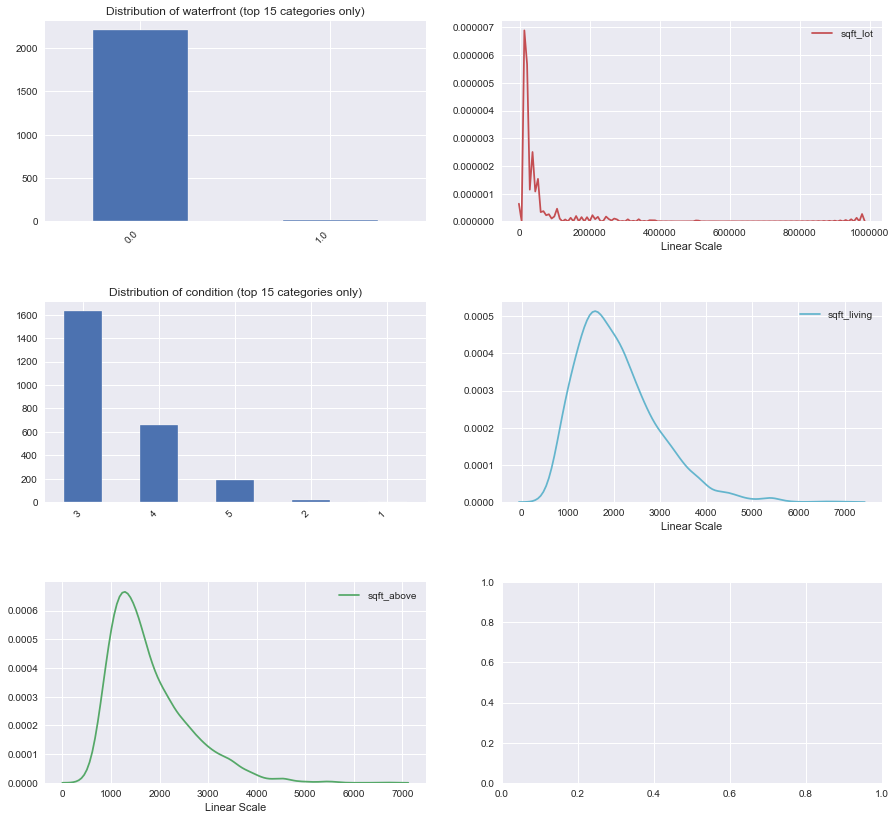

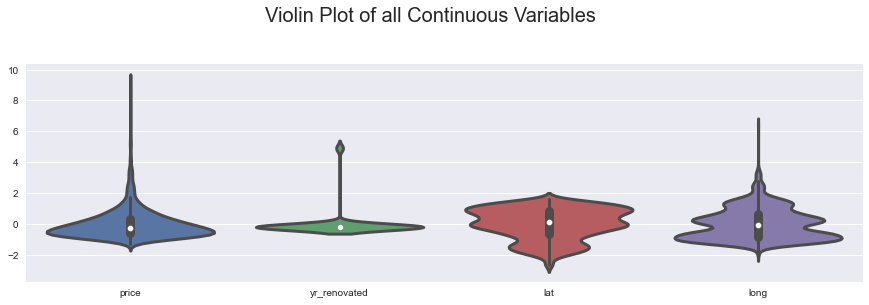

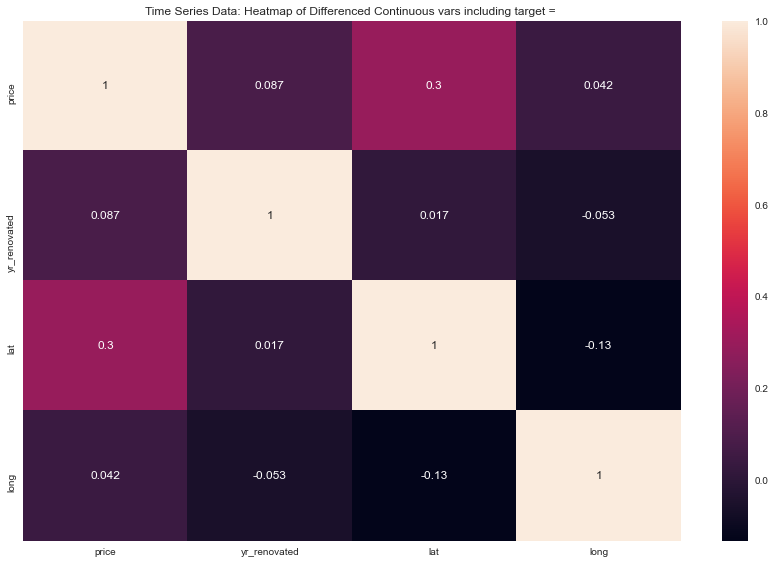

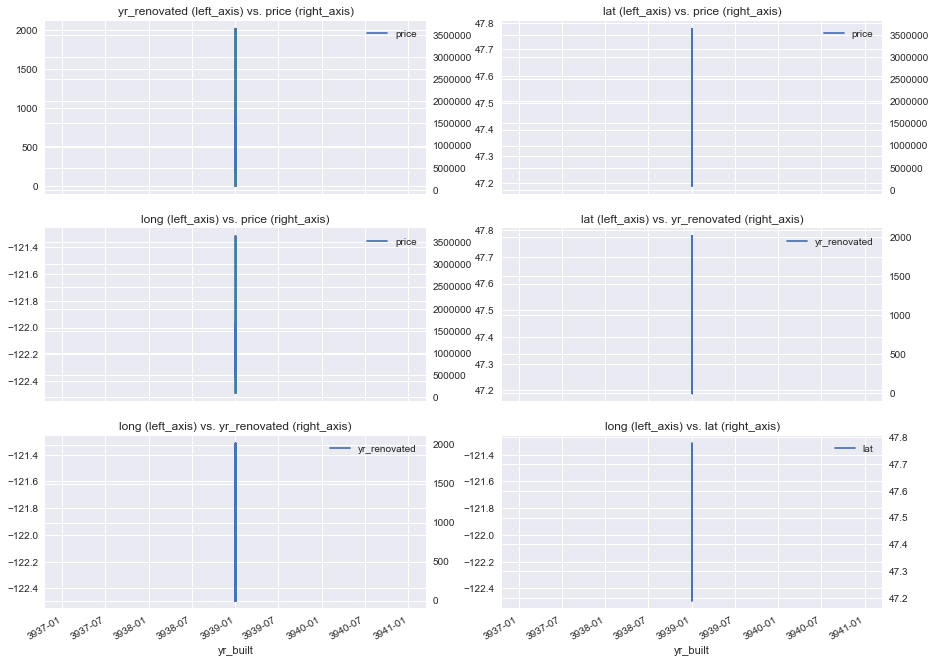

In [84]:
from autoviz.AutoViz_Class import AutoViz_Class
AV = AutoViz_Class()
dft = AV.AutoViz(filename = '', sep= ',' , dfte= df, header=0, verbose=2, lowess=False, chart_format='svg', max_rows_analyzed=2500, max_cols_analyzed= 21)
dft

In [91]:
# kchouse_cities.plot(kind='scatter', x='city', y = 'price')

In [ ]:
# pd.plotting.scatter_matrix(kchouse_base[kchouse_base.columns], figsize=(20,16));